
<style>
	
	code {
	  background-color: #9900cc;
	  //font-size: 25px;
	}
	
	mjx-container {
	  background-color: rgba(0, 0, 0, 0.0);
	}
	
	.reveal .slides {
		text-align: left;
		font-size: 25px;
		background-color: #000000;
	}
	
	strong {
		color: lightblue;
	}
	
	:root {
		--r-background-color: #000000;
		--r-heading-text-transform: none;
	} 

</style>

## Ausblick
<!-- element style="font-size: 250%" -->

# Grundlagen des Programmierens
<!-- element style="font-size: 90%" -->

<grid drag="45 10" drop="0 5">

<grid drag="33 100" drop="0 0">
IMWI <!-- element style="font-size: 250%" -->
</grid>

<grid drag="66 100" drop="30 0">
Institut für Musikinformatik <br> und Musikwissenschaft <!-- element style="font-size: 90%" -->
</grid>

</grid>

<grid drag="30 20" drop="70 2">

![[_hfm_logo_i.png|200]]

</grid>

<grid drag="20 10" drop="5 80">

08.07.2025

</grid>

---

## Bisher

+ CLI
+ Datenstrukturen
+ Funktionen
+ Conditionals
+ Schleifen
+ Git
+ Rekursion
+ OOP
+ Fehlerbehandlung
+ Debugging
+ Externe Module
	+ Rechen-effiziente Arrays mit `NumPy`
	+ Visualisierungen mit `Matplotlib`
	+ Spektrogramme und Audio-Verarbeitung mit `librosa`
	+ Midi-Daten (`mido`)

<br/>

---

## Ausblick

+ Machine Learning
+ Statistik
+ GUI
+ MIR
+ music21
+ Web-Interfaces

--

### Machine Learning


https://scikit-learn.org/stable/auto_examples/cluster/plot_cluster_comparison.html#sphx-glr-auto-examples-cluster-plot-cluster-comparison-py

In [1]:
!open .

In [2]:
import numpy as np, matplotlib.pyplot as plt, librosa as lr, pandas as pd, os
from IPython.display import Audio
from scipy.spatial.distance import cdist

In [3]:
audio = {}

sample_path = 'drums'

for file_name in os.listdir(sample_path):
    audio[file_name], sr = lr.load(os.path.join(sample_path, file_name))

--

### Machine Learning

In [4]:
attack_len = 0.1

feature_funcs = [lr.feature.rms, lr.feature.spectral_centroid, 
                 lr.feature.spectral_bandwidth, lr.feature.spectral_contrast, 
                 lr.feature.spectral_flatness, lr.feature.spectral_rolloff,
                 lr.feature.zero_crossing_rate]

feature_names = ['rms', 'spectral_centroid', 
                 'spectral_bandwidth', 'spectral_contrast', 
                 'spectral_flatness', 'spectral_rolloff',
                 'zero_crossing_rate']

features = {}

for key in audio:
    
    mean_features = {}

    for func, name in zip(feature_funcs, feature_names):
        
        attack_window = audio[key][:int(attack_len * sr)]
        feat = func(y=attack_window)
        mean_feat = np.mean(feat)
        mean_features[name] = mean_feat
    
    features[key] = mean_features

--

### Machine Learning

In [5]:
feat_df = pd.DataFrame(features).T

feat_df

,rms,spectral_centroid,spectral_bandwidth,spectral_contrast,spectral_flatness,spectral_rolloff,zero_crossing_rate
Cymatics - Thick Jug Perc.wav,0.256595,1381.126771,1879.440617,15.671621,0.013464,2631.357422,0.022656
Cymatics - Chimed Perc.wav,0.069092,2828.419721,2553.452670,22.478638,0.035823,5921.630859,0.133496
Cymatics - Homemade Shell Shaker 2.wav,0.005070,5661.280842,2490.544844,17.689698,0.178398,8234.296875,0.367285
kick_58.wav,0.177196,240.258486,785.424891,15.922534,0.000013,204.565430,0.006641
Cymatics - Soda Can 2.wav,0.070111,4121.365869,2891.392402,15.757249,0.203860,7730.419922,0.183301
...,...,...,...,...,...,...,...
kick_55.wav,0.263525,596.989008,1381.038286,13.805920,0.000433,906.547852,0.005762
kick_41.wav,0.287413,1372.495993,2122.850581,15.283889,0.003393,3335.493164,0.006348
Cymatics - Stacked Shakers 2.wav,0.017288,6875.248893,2540.615541,16.617376,0.169799,9618.881836,0.478711
Cymatics - Homemade Gravel Shaker 2.wav,0.003682,6696.572040,2514.605866,16.836823,0.169624,9130.078125,0.453418


In [6]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler(feature_range=(-1, 1))
scaled_features = scaler.fit_transform(feat_df)

print(scaled_features.min(axis=0))
print(scaled_features.max(axis=0))

[-1. -1. -1. -1. -1. -1. -1.]
[1. 1. 1. 1. 1. 1. 1.]


--

### Machine Learning

In [7]:
def kmeans(x, k, num_iter=20):
    
    # random centroids
    centroids = x[np.random.randint(x.shape[0], size=k)]
    
    # calculate distances
    distances = cdist(x, centroids, metric='euclidean')
    
    # select shortest distance to centroid
    points = np.argmin(distances, axis=1)
        
    for _ in range(num_iter):

        # re-center centroids
        for a in range(k):
            temp_centroid = np.mean(x[points == a], axis=0)
            centroids[a] = temp_centroid

        # calculate distances
        distances = cdist(x, centroids, metric='euclidean')

        # select shortest distance to centroid
        points = np.argmin(distances, axis=1)

    return points

In [8]:
k = 15

labels = kmeans(scaled_features, k=k)
labels

array([ 7,  2, 11, 13,  4,  0,  6,  6,  3,  4, 10, 13,  0, 11, 12, 14, 14,
        6,  0, 10,  8,  0, 11, 14,  3,  6,  7, 11,  2,  0,  1, 13,  1, 10,
        7, 14,  6, 11,  0, 14, 10,  4,  0,  6, 14, 14, 12, 11,  1, 11, 13,
       10, 11, 14,  3,  0, 11,  2, 10,  0,  7,  5, 14,  2,  6, 13,  2, 11,
        5, 11, 10,  2,  0, 14, 14,  1,  8,  1,  9, 10, 13,  7, 10,  9, 14,
       13,  2,  2, 10, 10, 14, 11,  4,  9, 12,  2,  1, 13, 13,  5,  5,  1,
        7,  9,  0, 14,  2, 14,  2, 10, 10, 11, 14,  7,  0,  1, 12,  5,  7,
       12, 13,  7,  1,  5, 12,  9,  2,  2,  8,  9,  9,  5,  1,  7, 12, 13,
        1,  9,  5, 13, 13,  4,  7,  5, 14, 12, 10, 13, 14, 11,  2,  7,  5,
        3, 11,  1,  2, 13, 13, 11,  1, 13, 13,  2,  4,  1, 13,  4, 10,  0,
        4,  5,  7, 13,  9,  7,  7,  2,  7,  3, 10, 13,  9, 13,  2,  9, 13,
        2, 13, 12,  2,  5, 13, 14,  2,  3,  7,  4,  1,  7,  9,  2,  5,  7,
        1,  3, 11,  1, 14, 13, 14, 13, 13,  4, 13,  2,  0,  2,  3,  2,  1,
        5, 13,  4,  9, 14

--

### Machine Learning

In [9]:
for k_ in range(k):
    
    concat_audio = np.array([])
    
    for key in feat_df.index[labels == k_]:
        concat_audio = np.append(concat_audio, audio[key])

    display(Audio(concat_audio, rate=sr))

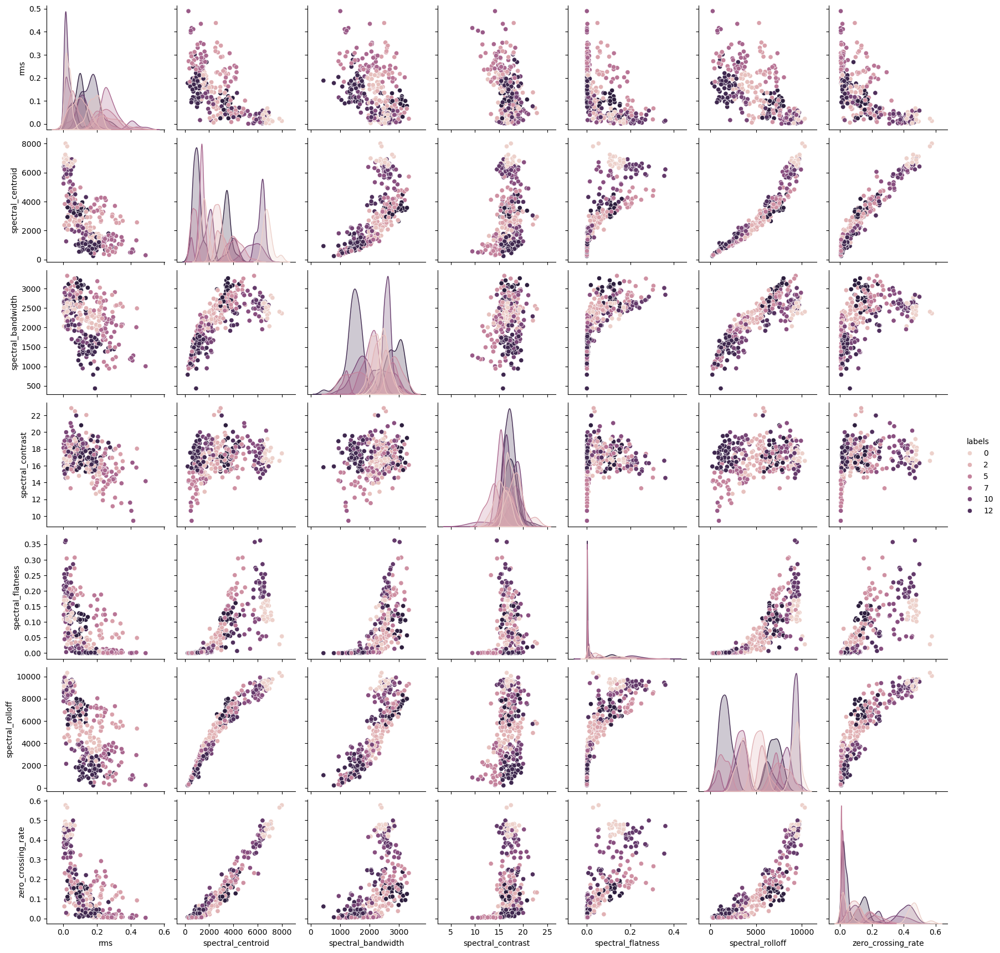

In [10]:
import seaborn as sn

labelled_features = pd.concat((feat_df, pd.Series(labels, name='labels', index=feat_df.index)), axis=1)

sn.pairplot(labelled_features, hue='labels')

--

### Statistik

In [11]:
import mido
from pathlib import Path

midifile_path = Path('bwv772.mid')
midifile = mido.MidiFile(midifile_path)

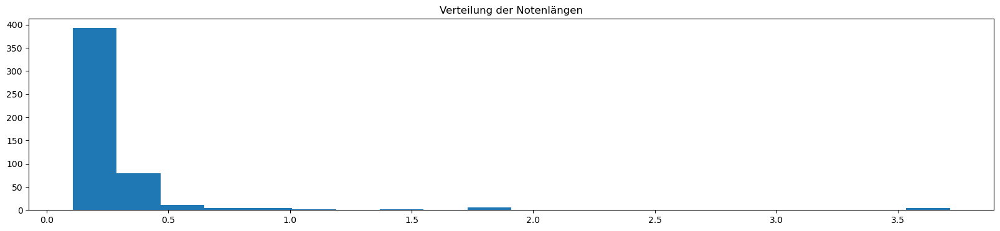

In [12]:
for msg in midifile:
    if msg.type == 'set_tempo':
        tempo = msg.tempo


class MidiNote:

    def __init__(self, note, velocity, time_on, time_off):
        self.note = note
        self.velocity = velocity
        self.time_on = time_on
        self.time_off = time_off

    def __repr__(self):
        return f'<MidiNote: note: {self.note}, velocity: {self.velocity}, on: {self.time_on}, off: {self.time_off}>'


onset_notes = {}
sequence = []
abs_time = 0

# track 1
track1 = midifile.tracks[1]
for i, msg in enumerate(track1):

        abs_time += mido.tick2second(msg.time, midifile.ticks_per_beat, tempo)

        if msg.type == 'note_on':
            onset_notes[msg.note] = [MidiNote(note=msg.note, velocity=msg.velocity, time_on=abs_time, time_off=0)]
        if msg.type == 'note_off':
            midinote = onset_notes.get(msg.note).pop(0)
            midinote.time_off = abs_time
            sequence.append(midinote)


note_durations = [note.time_off - note.time_on for note in sequence]
plt.figure(figsize=(20, 4))
plt.hist(note_durations, bins=20)
plt.title("Verteilung der Notenlängen")
plt.show()

--

### GUI

In [13]:
import dearpygui.dearpygui as dpg
import mido

def load_midi_file(sender, app_data, user_data):
    path = dpg.get_value("midi_path")
    try:
        mid = mido.MidiFile(path)
        output = f"MIDI-Datei geladen:\nSpuren: {len(mid.tracks)}\n\n"
        for i, track in enumerate(mid.tracks):
            output += f"Track {i}: \"{track.name}\", Events: {len(track)}\n"
        dpg.set_value("output", output)
    except Exception as e:
        dpg.set_value("output", f"Fehler beim Laden:\n{e}")

dpg.create_context()
dpg.create_viewport(title='MIDI-Viewer', width=600, height=400)

with dpg.window(label="MIDI Analyse", width=580, height=380):
    dpg.add_text("Pfad zur MIDI-Datei")
    dpg.add_input_text(label="", tag="midi_path", default_value="/Pfad/zur/Datei.mid", width=500)
    dpg.add_button(label="Laden", callback=load_midi_file)
    dpg.add_input_text(tag="output", multiline=True, width=550, height=250, readonly=True)

dpg.setup_dearpygui()
dpg.show_viewport()
dpg.start_dearpygui()
dpg.destroy_context()

--

### MIR

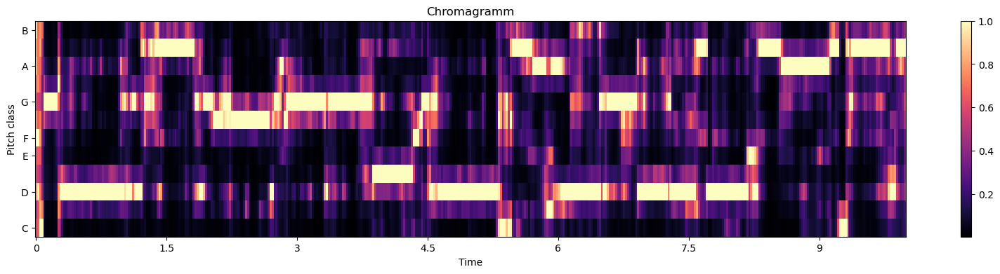

In [14]:
import librosa, librosa.display
import matplotlib.pyplot as plt

y, sr = librosa.load(librosa.example('brahms'), duration=10)
chroma = librosa.feature.chroma_stft(y=y, sr=sr)

plt.figure(figsize=(20,  4))
librosa.display.specshow(chroma, y_axis='chroma', x_axis='time')
plt.colorbar()
plt.title("Chromagramm")
plt.show()

--

### music21

In [15]:
from music21 import converter

score = converter.parse("BWV066_Choro.mxl")
key = score.analyze('key')
print(f"Tonart: {key.tonic.name} {key.mode}")

Tonart: D major


--

### Sardine

https://sardine.raphaelforment.fr/showcase/acousmatic_tekno.html

--

### Web-Interfaces

module, wie z.b. `streamlit` oder `flask`

In [ ]:
!streamlit run streamlit.py


  You can now view your Streamlit app in your browser.

  Local URL: http://localhost:8501
  Network URL: http://10.172.213.169:8501

  For better performance, install the Watchdog module:

  $ xcode-select --install
  $ pip install watchdog
            


```Python
# Datei: streamlit.py
import streamlit as st
import mido

uploaded = st.file_uploader("MIDI-Datei hochladen", type="mid")

if uploaded:
    mid = mido.MidiFile(file=uploaded)
    for i, track in enumerate(mid.tracks):
        st.write(f"Track {i}: {track.name}, Events: {len(track)}")

# Terminal: streamlit run streamlit.py
```

---

## Projektarbeit

### Mögliche Themen

- DTMF
- MIDI-Toolbox erweitern
- Graphische Ausgabe von symbolischen Daten
- individuelle Absprache